# Clustering

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
plt.rcParams['figure.dpi'] = 200

## TEXT

In [ ]:
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans

# set a random seed
np.random.seed(1)

# A list of centres of clusters
true_centres = [[1, 1], [5, 3], [-2, -4]]

points, clusters = make_blobs(
    n_samples=[50, 100, 150], # number of samples in each cluster
    centers=true_centres,     # where are the centres?
)


labelled_points = pd.DataFrame({'cluster': clusters,
                                'x1': points[:, 0],
                                'x2': points[:, 1]})
display(labelled_points.head())

In [ ]:
scat1 = plt.scatter(labelled_points['x1'], labelled_points['x2'], cmap=plt.cm.tab10, 
                      alpha=0.7)
centres_df = pd.DataFrame.from_records(true_centres, columns=['x', 'y'])
sns.scatterplot(x=centres_df['x'], y=centres_df['y'], alpha=0.9, marker='o', s=120, linewidths=8,
                      color='w')
sns.scatterplot(x=centres_df['x'], y=centres_df['y'], marker='x', s=60, linewidths=20, color='k')

plt.show()

## How Does k-Means Work?

The traditional method can be summerised by the following steps<sup>1</sup>:

> 1. Randomly pick *k* centeroids from the sample points as initial cluster centers.
2. Assign each sample to the nearest centroid $\mu^{(j)}, j∈\{1,...,k\}$.
3. Move the centroids to the center of the samples that were assigned to it.
4. Repeat steps 2 and 3 until the cluster assignments do not change or a user-defined tolerance or maximum number of iterations is reached.

Often distance is measured using the **squared Euclidean distance** and the k-means algorithm can be described as an iterative approach which minimises the within-cluster **Sum of Squared Errors** (or cluster inertia - see above).

Below demonstrates how this process looks in practice.

---
1. Raschka, S., & Mirjalili, V. (2019). Python machine learning: Machine learning and deep learning with Python, scikit-learn, and TensorFlow 2. Packt Publishing Ltd.

In [ ]:
from matplotlib import animation, rc
from IPython.display import HTML

kclust = labelled_points[['x1', 'x2']]

def update_plot(i, models, scat1, scat2, scat3):
    if models[int(i/2)]==None:
        # set 1 standard color
        scat1.set_array(np.array([0]*len(kclust)))
        # makes sure the x's are not plotted
        empty_np = np.empty(models[-1].cluster_centers_.shape)
        empty_np[:]=np.NaN
        scat2.set_offsets(empty_np)
        scat3.set_offsets(empty_np)
    else:
      if (i % 2) == 0:
        # changes position
        scat2.set_offsets(models[int(i/2)].cluster_centers_)
        scat3.set_offsets(models[int(i/2)].cluster_centers_)
      else:
        # changes color
        scat1.set_array(models[int(i/2)].predict(kclust))
    
    return scat3,


def k_means_vis(n_clusters=3, init = "random", n_init = 1, 
                 max_iter=15, random_state=1):
  
    k_iters = []
    for init_seed in range(n_init):
        # just adds a break between starting with new centeroids
        [k_iters.append(None) for i in range(2)]

        for i in range(1,max_iter+1):
            km = KMeans(n_clusters=3, init=init, n_init=1,
                      algorithm="full", max_iter=i, 
                      random_state=random_state+init_seed)
            k_iters.append(km.fit(kclust))

    numpoints = len(kclust)
    colors = k_iters[-1].predict(kclust)

    fig = plt.figure()

    scat1 = plt.scatter(kclust['x1'], kclust['x2'], c=colors, cmap=plt.cm.tab10, 
                      alpha=0.7)
    scat2 = plt.scatter([],[],
                      alpha=0.9, marker='o', s=40, linewidths=8,
                      color='w')
    scat3 = plt.scatter([],[],
                      marker='x', s=20, linewidths=20, c='k')
    ani = animation.FuncAnimation(fig, update_plot, 
                                frames=range(len(k_iters)*2),
                                fargs=(k_iters, scat1, scat2, scat3),
                                interval=100
                                )

    # Note: below is the part which makes it work on Colab
    rc('animation', html='jshtml')
    return ani

In [ ]:
k_means_vis()

However this method is dependent on where the centeroid is initalised - it may converge to a local optimum as shown when we change the random state...

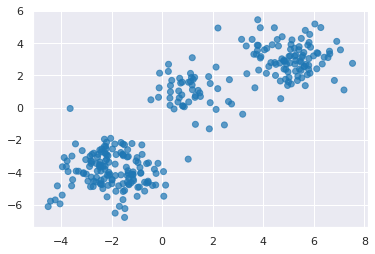

In [ ]:
k_means_vis(random_state=2)

There are therefore two improvements commonly used on the baseline method, the first is running the k-means algorithm with different centroid seeds and picking the best one based on inertia.

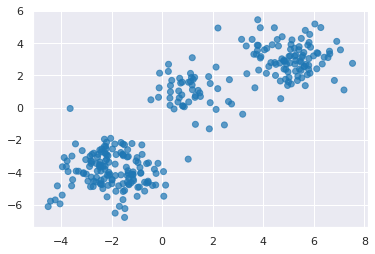

In [ ]:
k_means_vis(n_init=10)

The second, and the default method in Sklearn, is to use K-Means++<sup>1</sup>. Instead of initializing the centroids randomly, it is preferable to initialize them first<sup>2</sup>:

> 1.   Take one centroid $c_1$, chosen uniformly at random from the dataset.
> 2.   Take a new center $c_i$, choosing an instance $\mathbf{x}_i$ with probability: $D(\mathbf{x}_i)^2$ / $\sum\limits_{j=1}^{m}{D(\mathbf{x}_j)}^2$ where $D(\mathbf{x}_i)$ is the distance between the instance $\mathbf{x}_i$ and the closest centroid that was already chosen. This probability distribution ensures that instances that are further away from already chosen centroids are much more likely be selected as centroids.
> 3. Repeat the previous step until all $k$ centroids have been chosen.

After using this for initializing centroids, we use the K-Means algorithm as before. As this initialisation means we are less likely to converge at a suboptimal solution, we can reduce `n_init` to compensate for the computational cost incurred by this extra step.

---
1. Arthur, D., & Vassilvitskii, S. (2006). k-means++: The advantages of careful seeding. Stanford.
2. Géron, A. (2019). Hands-on machine learning with Scikit-Learn, Keras, and TensorFlow: Concepts, tools, and techniques to build intelligent systems. O'Reilly Media.

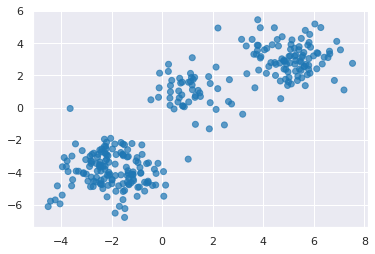

In [ ]:
k_means_vis(n_init=5, init = "k-means++")

## Plotting Centeroids

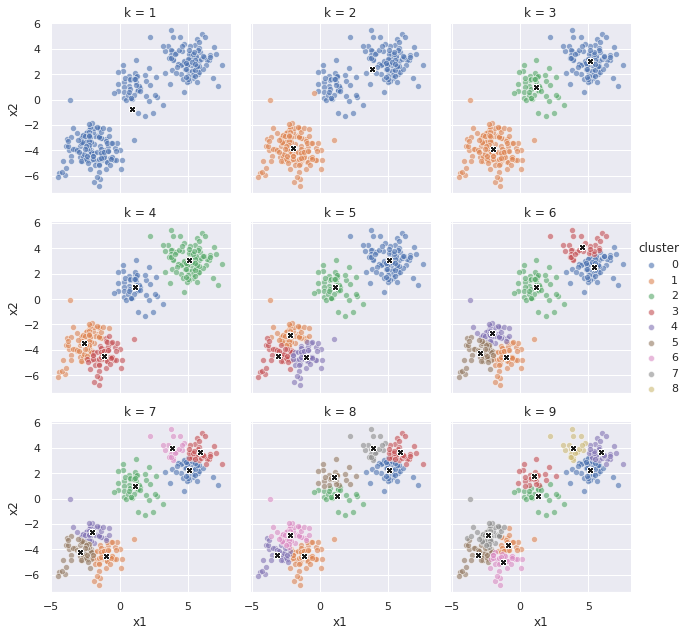

In [ ]:
for k in list(range(1, 10)):
    kclust = labelled_points[['x1', 'x2']]
    km = KMeans(n_clusters=k, random_state=1).fit(kclust)
    kclust['cluster'] = km.fit_predict(kclust)
    kclust['k']=k
    
    centeroids = pd.DataFrame(km.cluster_centers_, columns=['c1', 'c2'])
    centeroids.index.name = 'cluster'
    centeroids['k'] =k
    centeroids = centeroids.reset_index()
    
    if k==1:
      allkclust = kclust
      allcenteroids = centeroids
    else:
      allkclust = pd.concat([allkclust, kclust], axis=0)
      allcenteroids = pd.concat([allcenteroids,centeroids])

fig = sns.FacetGrid(allkclust.merge(allcenteroids), col='k', hue='cluster', col_wrap=3)

fig.map(sns.scatterplot, 'c1', 'c2', alpha=0.9, marker='o', s=40, linewidths=8,
        color='w', zorder=10, legend=False)
fig.map(sns.scatterplot, 'c1', 'c2', marker='x', s=20, linewidths=20,
                color='k', zorder=11, alpha=1, legend=False)
fig.map(sns.scatterplot, 'x1', 'x2', alpha=0.6)

fig.add_legend()
plt.show()

## Silhouette Score

A silhouette score is $(b-a)/$max$(a,b)$ where $a$ is the mean distance to the other instances in the same cluster and $b$ the mean nearest-cluster distance. It can vary between -1 and +1 with coefficients close to +1 indicating instances are generally inside their own cluster and away from other ones, and -1 meaning they may be assigned to the wrong cluster.

However, this plot shows 2 being the highest and 3 (our chosen number of clusters) second. Doesn't this indicate that we should pick 2 instead? Well its just highlighting one of the limitations of K-means: it performs poorly when there are clusters of different sizes, densities, or the shapes are nonsperical.

Furthermore you may want to follow this up with other silhouette analysis techniques.

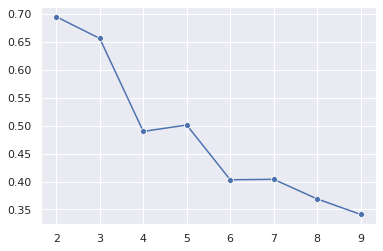

In [ ]:
from sklearn.metrics import silhouette_score
silhouette_scores = []
k_list = list(range(2, 10))
for k in k_list:
    kclust = labelled_points[['x1', 'x2']]
    km = KMeans(n_clusters=k, random_state=1).fit(kclust)
    silhouette_scores.append(silhouette_score(kclust, km.labels_))

sns.lineplot(x=k_list,y=np.array(silhouette_scores), marker='o')
#plt.axvline(3, linestyle='--')
plt.show()

# Assignment Notes
I would add to the assignment:
1. Understanding the limitations of the method - highlighted in this case by plotting the silhouette score
2. Difference between hard and soft clustering? Depends if we teach fuzzy k-means.